In [8]:
import numpy as np
from matplotlib import pyplot as plt
# from matplotlib import patches as patches
import cv2, os

In [9]:
#Equalize an RGB image with support for 16bit {as OpenCV equalizeHist only suports 8bits}

def equalize(image, bpp):
    #cv2.COLOR_RGB2HSV doesn't support 16bit images so must use float32
    hsv = cv2.cvtColor((image/2**bpp).astype(np.float32), cv2.COLOR_RGB2HSV)
    #Calculate Histogram
    hist = cv2.calcHist([hsv[:,:,2].ravel()],[0],None,[2**bpp],[0,1])


    #Find cumulitive sum of source
    cs = hist.cumsum()
    nj = (cs - cs.min())
    N = cs.max() - cs.min()

    # re-normalize the cdf
    cs = nj / N
    #Create integer lookup for the CDF
    value_index = np.uint16(hsv[:,:,2]*((2**bpp)-1))

    #Assign new value from cumulative sum
    hsv[:,:,2] = cs[value_index[:,:]]

    #Convert back to RGB 16bit
    eq_rgb = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
    eq_rgb = np.uint16(eq_rgb*(2**bpp-1))

    return eq_rgb

In [13]:
#Set base directory
working_directory = 'C:/Users/jake.hawkins/OneDrive - TEAM EAGLE LTD/Documents/RCAM/10bit comparison'
os.chdir(working_directory)

# image_folder = 'images/suvojit/Indoors 350lux/'
image_folder = 'images/suvojit/Outdoors 11000lux/'

os.chdir(image_folder)

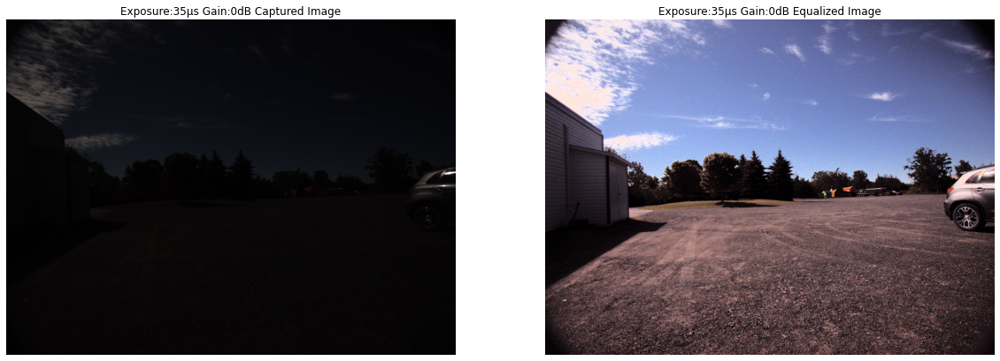

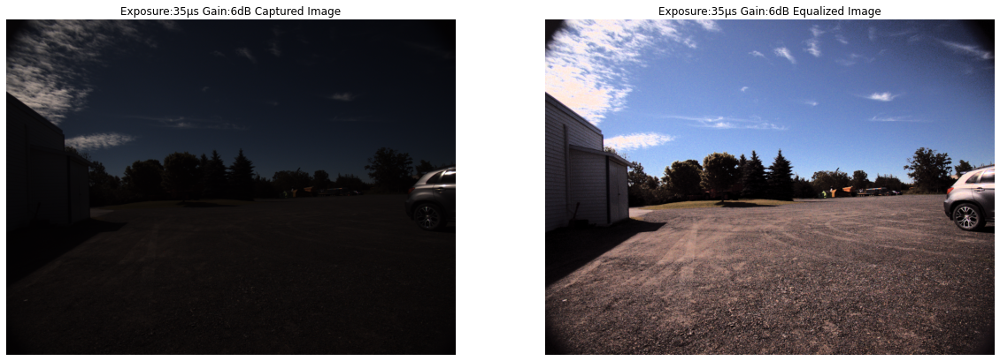

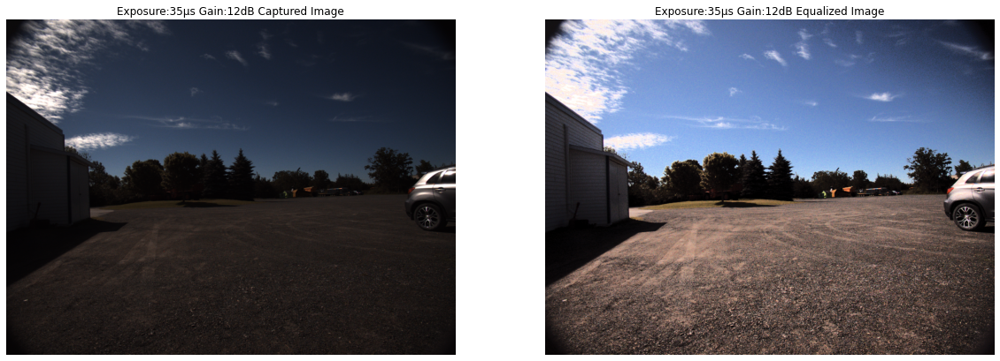

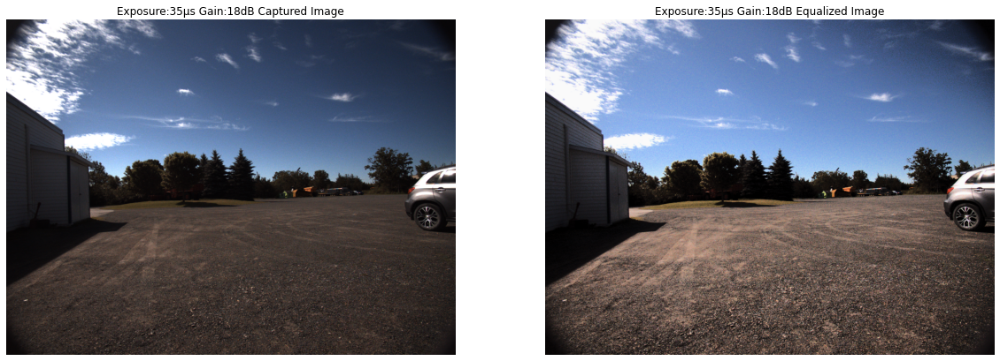

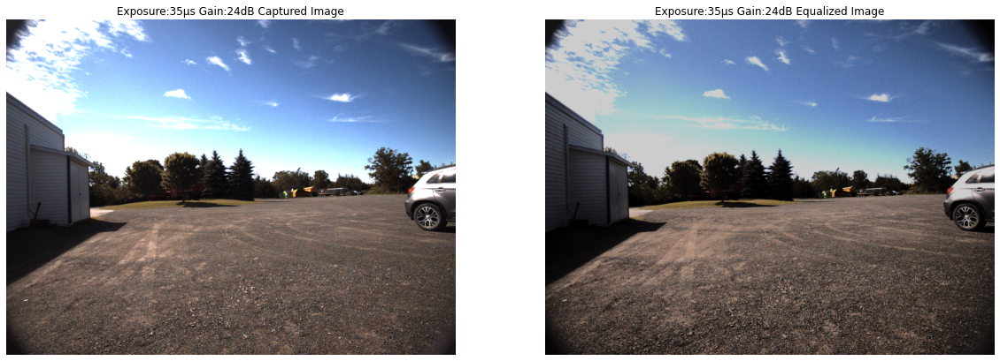

...

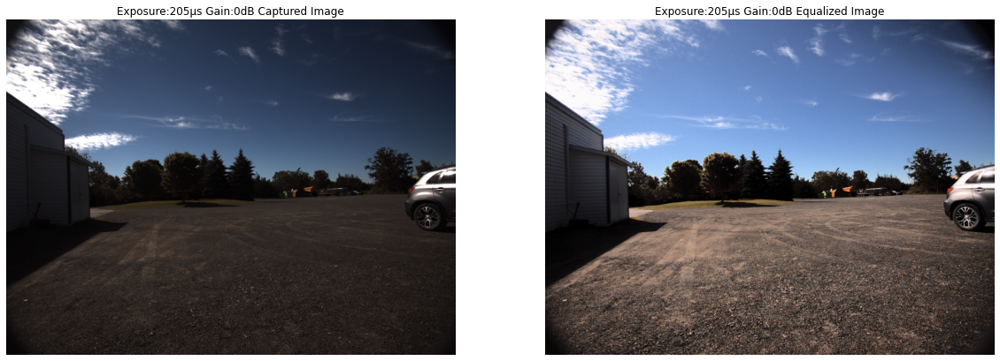

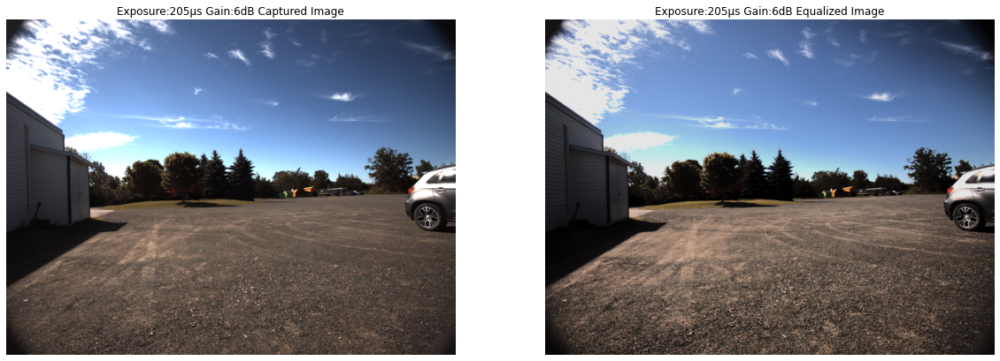

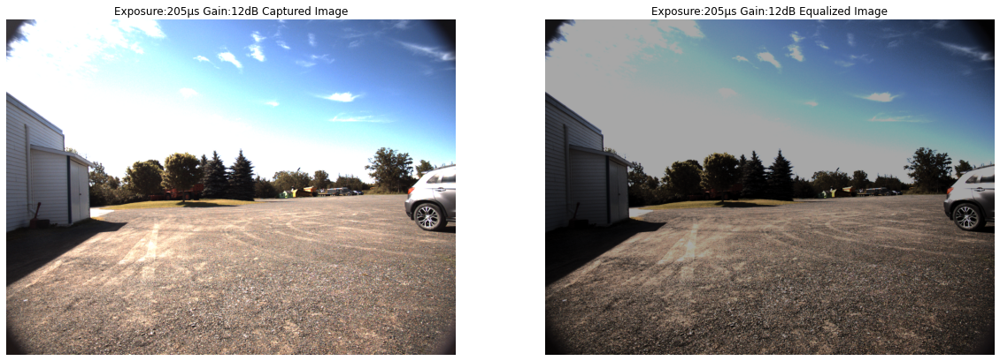

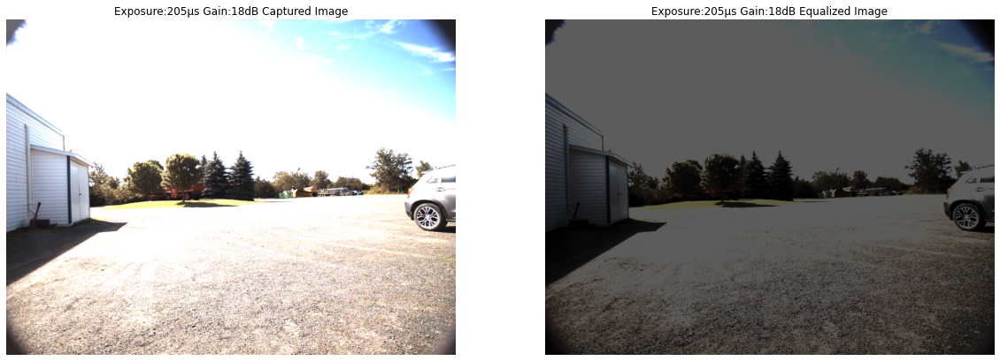

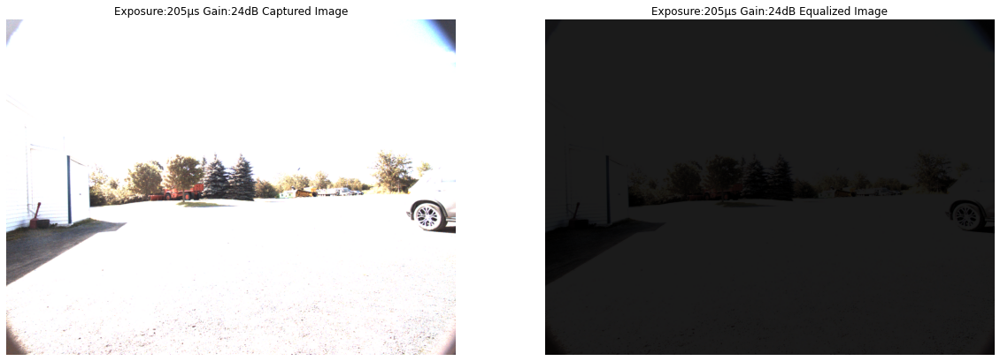

In [16]:
bpp = 16

for  exposure in ['35','56','98','141','205']:
    for gain in ['0','6','12','18','24']:
        raw_img = cv2.imread("mako_319_{}us+{}dB.tiff".format(exposure, gain), -1)
        colour_img = cv2.cvtColor(raw_img, cv2.COLOR_BayerRG2BGR)
        cv2.imwrite("mako_319_{}us+{}dB_colour.tiff".format(exposure, gain), colour_img)
        eq_img = equalize(colour_img, bpp)
        cv2.imwrite("mako_319_{}us+{}dB_colour_eq.tiff".format(exposure, gain), eq_img)
        
        #Display in Jupyter     
        fig = plt.figure()
        fig.set_figheight(15)
        fig.set_figwidth(20)
        fig.add_subplot(1,2,1)
        plt.axis('off')
        plt.title('Exposure:{}µs Gain:{}dB Captured Image'.format(exposure, gain))
        plt.imshow(colour_img>>bpp-8)
        fig.add_subplot(1,2,2)
        plt.axis('off')
        plt.imshow(eq_img>>bpp-8)
        plt.title('Exposure:{}µs Gain:{}dB Equalized Image'.format(exposure, gain))
        plt.show(block=True)        
